# <font color='purple'>dNLS Preprocessing QC statistics </font> 
### June 2025

In [60]:
import os
NOVA_HOME = '/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps'
NOVA_DATA_HOME = '/home/projects/hornsteinlab/Collaboration/MOmaps'
LOGS_PATH = os.path.join("/home/projects/hornsteinlab/Collaboration/NOVA/outputs/OperadNLS_80pct/logs")

PLOT_PATH = None
os.chdir(NOVA_HOME)
import pandas as pd
import numpy as np
import contextlib
import io
from IPython.display import display, Javascript

from tools.preprocessing_tools.qc_reports.qc_utils import log_files_qc, run_validate_folder_structure, display_diff, sample_and_calc_variance, \
                                                show_site_survival_dapi_brenner, show_site_survival_dapi_cellpose, \
                                                show_site_survival_dapi_tiling, show_site_survival_target_brenner, \
                                                calc_total_sums, plot_filtering_heatmap, show_total_sum_tables, \
                                                plot_cell_count, plot_catplot, plot_hm_of_mean_cell_count_per_tile, \
                                                run_calc_hist_new, show_total_valid_tiles_per_marker_and_batch
                                                
from tools.preprocessing_tools.qc_reports.qc_config import dnls_opera_panels, dnls_opera_markers, dnls_opera_marker_info, \
                                                           dnls_opera_cell_lines, \
                                                dnls_opera_cell_lines_to_cond, dnls_opera_cell_lines_for_disp, dnls_opera_reps, \
                                                dnls_opera_line_colors, dnls_opera_lines_order, dnls_opera_custom_palette, \
                                                dnls_opera_expected_dapi_raw, markers, custom_palette,dnls_opera_cell_lines_to_reps

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# choose batches
batches = [f'batch{i}' for i in range(1,7)]
batches

['batch1', 'batch2', 'batch3', 'batch4', 'batch5', 'batch6']

In [26]:
df = log_files_qc(LOGS_PATH, only_wt_cond=False, batches=batches, filename_split='-',site_location=0)
# # we are not using the wt line eventually
# df = df[df.cell_line != 'WT']

df_dapi = df[df.marker=='DAPI']
df_target = df[df.marker!='DAPI']

reading logs of batch5
reading logs of batch6
reading logs of batch3
reading logs of batch2
reading logs of batch4
reading logs of batch1

Total of 12 files were read.
Before dup handeling  (308234, 21)
After duplication removal #1: (300473, 22)
After duplication removal #2: (300473, 22)


## Actual Files Validation

### Raw Files Validation

1. How many site **tiff** files do we have in each folder?
2. Are all existing files valid? (tif, at least 2049kB, not corrupetd)

batch1
Folder structure is valid.
No bad files are found.
Total Sites:  82000


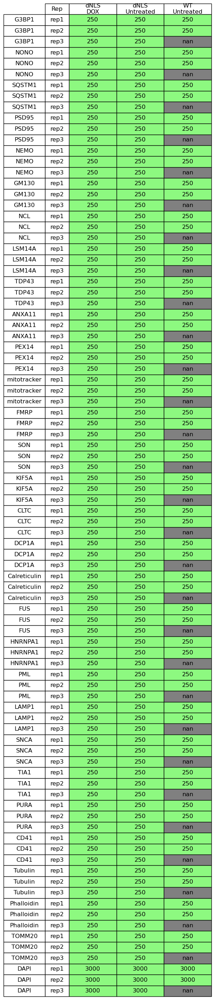

batch2
Folder structure is valid.
No bad files are found.
Total Sites:  82000


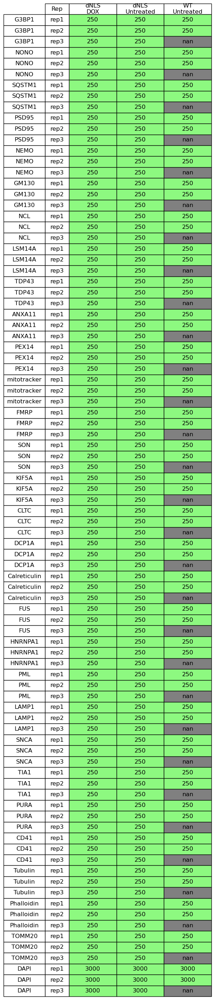

batch3
Folder structure is valid.
No bad files are found.
Total Sites:  82000


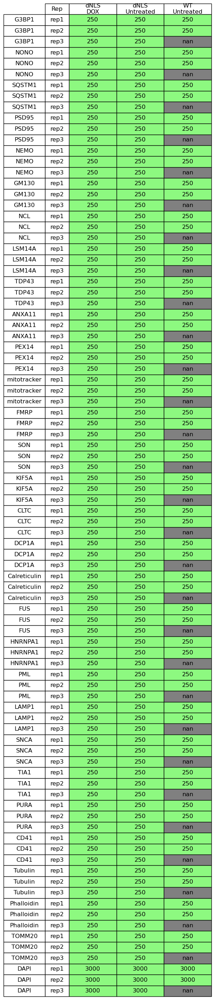

batch4
Folder structure is valid.
No bad files are found.
Total Sites:  82000


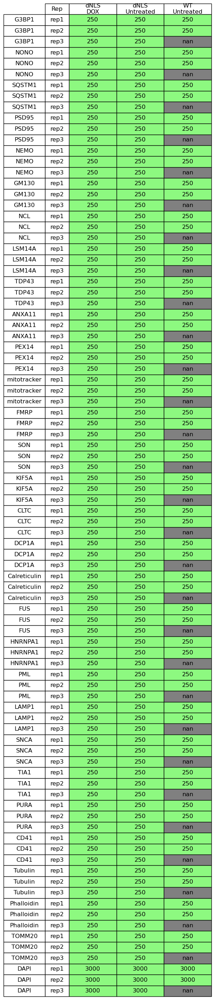

batch5
Folder structure is valid.
No bad files are found.
Total Sites:  81736


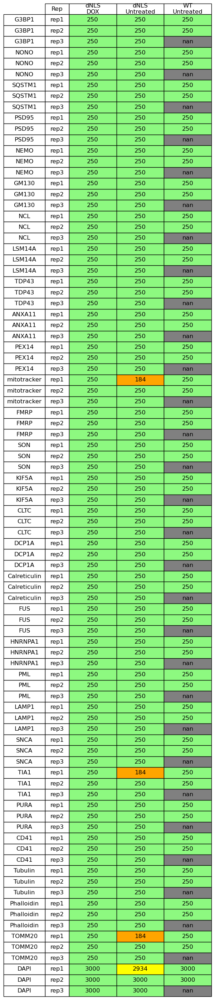

batch6
Folder structure is valid.
No bad files are found.
Total Sites:  81997


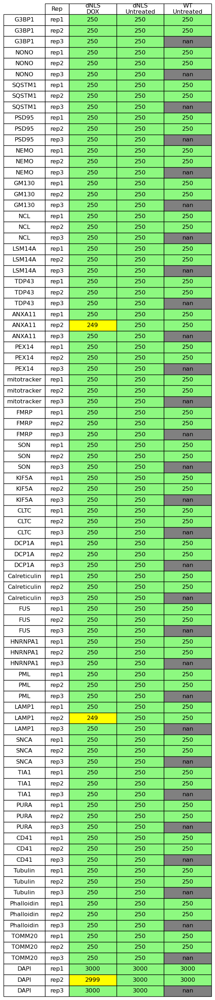

In [14]:

root_directory_raw = os.path.join(NOVA_DATA_HOME, 'input', 'images', 'raw', 'OPERA_dNLS_6_batches_NOVA_sorted')

raws = run_validate_folder_structure(root_directory_raw, False, dnls_opera_panels, dnls_opera_markers.copy(),PLOT_PATH, dnls_opera_marker_info,
                                    dnls_opera_cell_lines_to_cond, dnls_opera_reps, dnls_opera_cell_lines_for_disp, 
                                    dnls_opera_expected_dapi_raw,
                                     batches=batches, fig_width=2,fig_height=12,cell_lines_to_reps=dnls_opera_cell_lines_to_reps,
                                     expected_count=250, check_antibody=False)


### Processed Files Validation

1. How many site **npy** files do we have in each folder? -> How many sites survived the pre-processing?
2. Are all existing files valid? (at least 100kB, npy not corrupted)

batch1
Folder structure is valid.
No bad files are found.
Total Sites:  40890


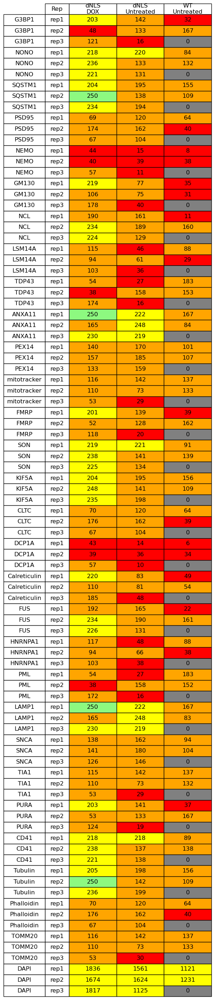

batch2
Folder structure is valid.
No bad files are found.
Total Sites:  41011


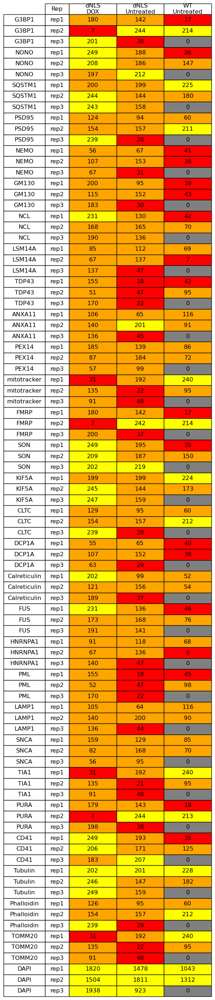

batch3
Folder structure is valid.
No bad files are found.
Total Sites:  14183


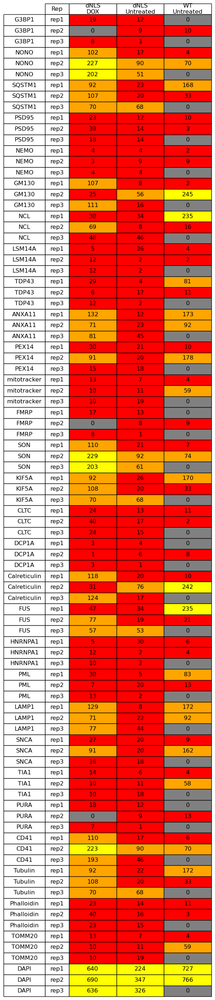

batch4
Folder structure is valid.
No bad files are found.
Total Sites:  70442


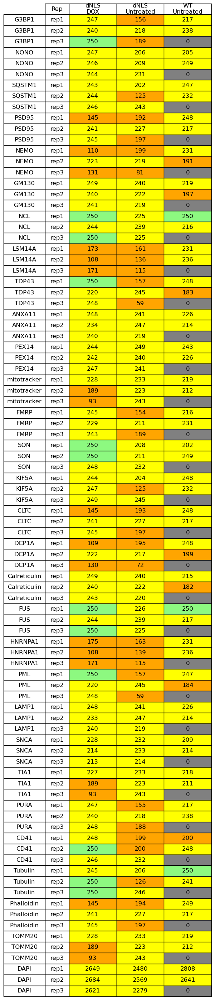

batch5
Folder structure is valid.
No bad files are found.
Total Sites:  77611


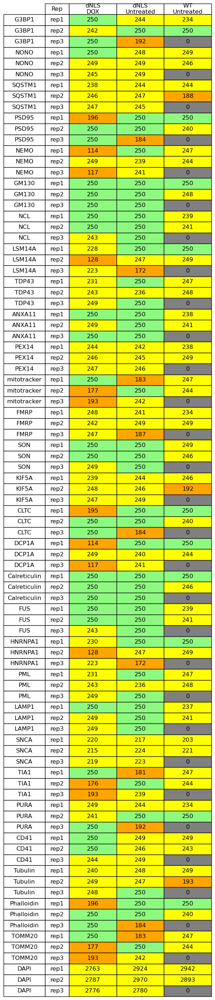

batch6
Folder structure is valid.
No bad files are found.
Total Sites:  28171


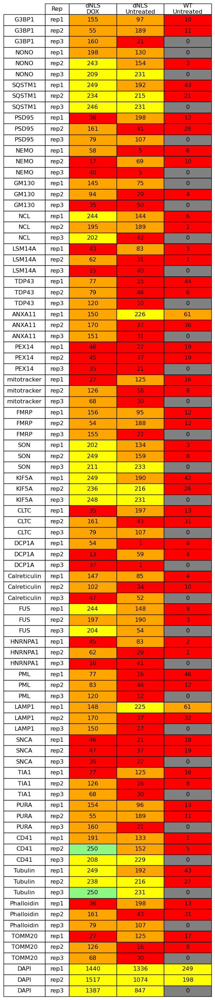

In [27]:
root_directory_proc = os.path.join(NOVA_DATA_HOME, 'input', 'images', 'processed', 'OperadNLS_80pct')
procs = run_validate_folder_structure(root_directory_proc, True, dnls_opera_panels, dnls_opera_markers,PLOT_PATH,dnls_opera_marker_info,
                                    dnls_opera_cell_lines_to_cond, dnls_opera_reps, dnls_opera_cell_lines_for_disp, dnls_opera_expected_dapi_raw,
                                    fig_width=2,fig_height=12,cell_lines_to_reps=dnls_opera_cell_lines_to_reps,
                                     expected_count=250, check_antibody=False, batches=batches)

### Difference between Raw and Processed

batch1


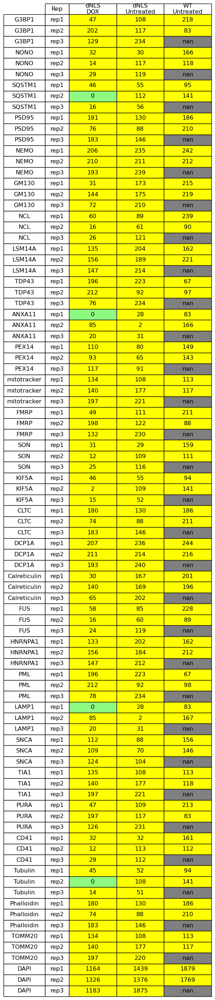

batch2


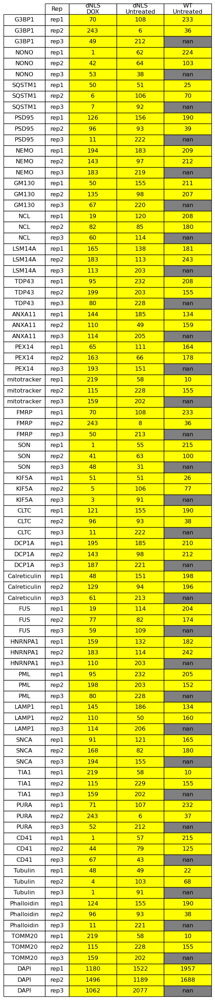

batch3


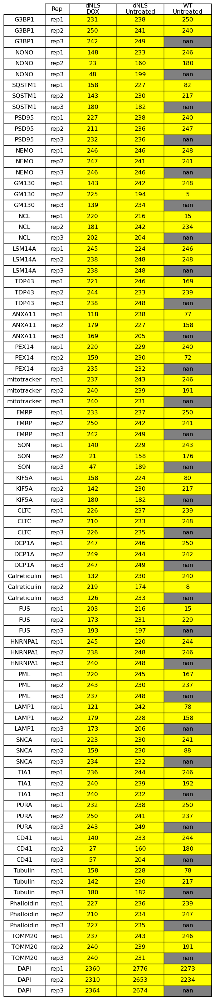

batch4


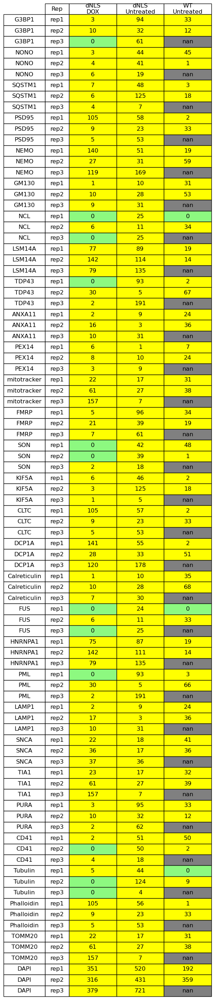

batch5


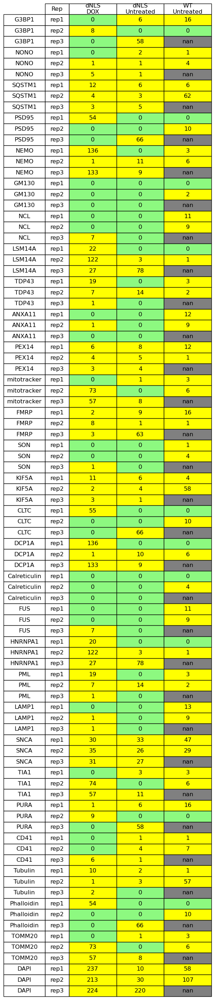

batch6


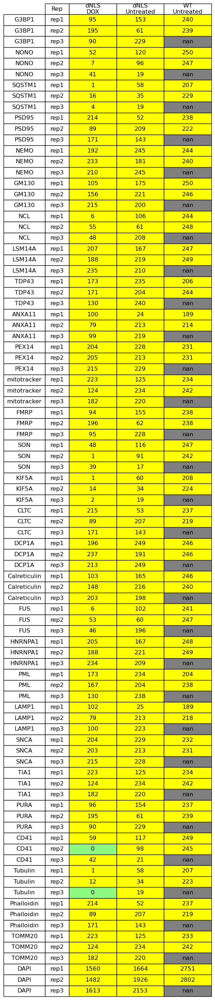

In [28]:
display_diff(batches, raws, procs, PLOT_PATH, fig_width=2,fig_height=12)

### Variance in each batch (of processed files)

In [29]:
for batch in batches:
    with contextlib.redirect_stdout(io.StringIO()):
        var = sample_and_calc_variance(root_directory_proc, batch, 
                                       sample_size_per_markers=500, cond_count=2, rep_count=len(dnls_opera_reps), 
                                       num_markers=len(dnls_opera_markers))
    print(f'{batch} var: ',var)

batch1 var:  0.02333956918601448
batch2 var:  0.024308358038367922
batch3 var:  0.020571351483098417
batch4 var:  0.022824750863657463
batch5 var:  0.021577597641420837
batch6 var:  0.02165809939276764


## Preprocessing Filtering qc
By order of filtering

### 1. % site survival after Brenner on DAPI channel
Percentage out of the total sites

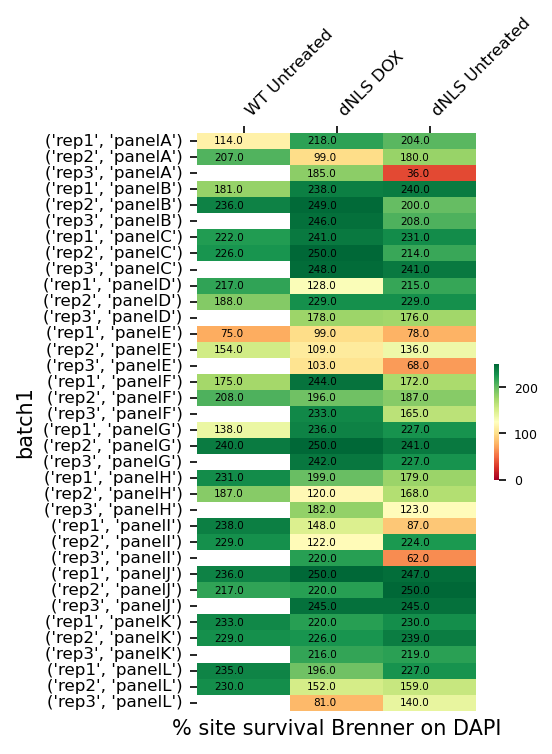

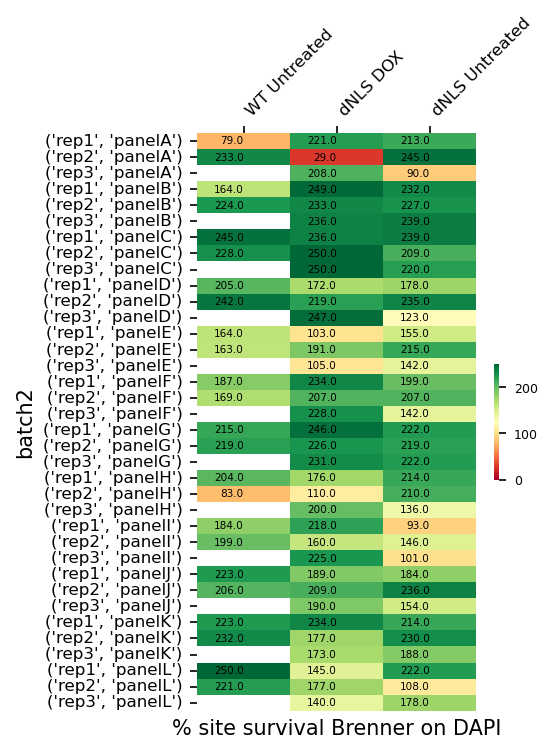

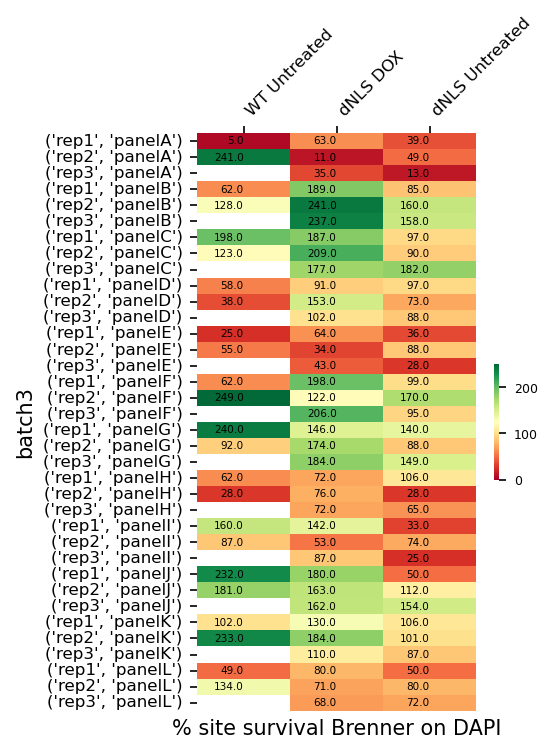

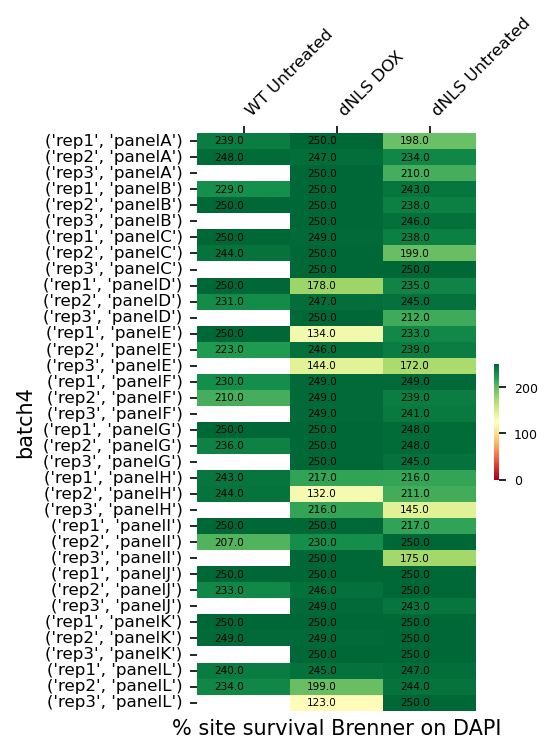

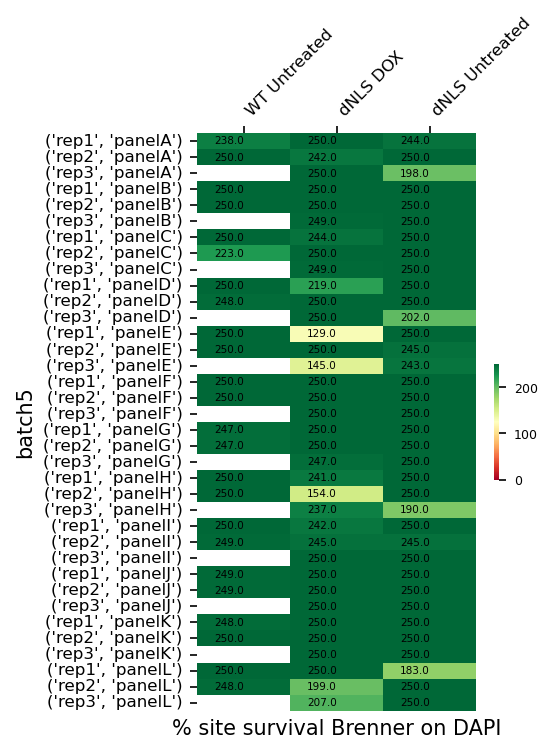

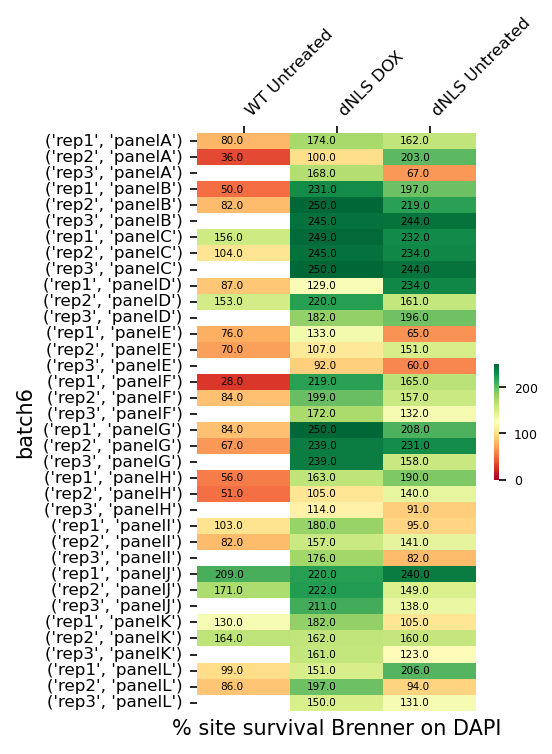

In [30]:
dapi_filter_by_brenner = show_site_survival_dapi_brenner(df_dapi,batches, dnls_opera_line_colors, dnls_opera_panels, 
                                                        dnls_opera_reps, figsize=(3,5),vmax=250, 
                                                         to_ignore={'cell_line_cond':'WT Untreated','rep':'rep3'})

### 2. % Site survival after Cellpose
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values.

**A site will be filtered out if Cellpose found 0 cells in it.**

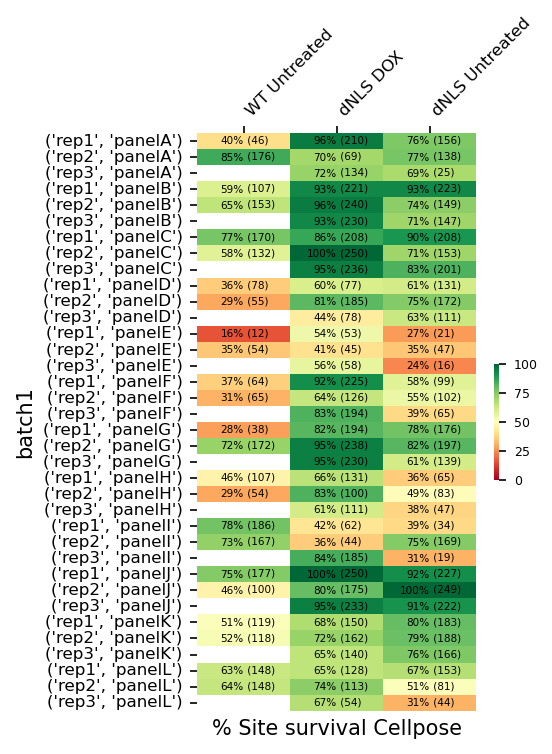

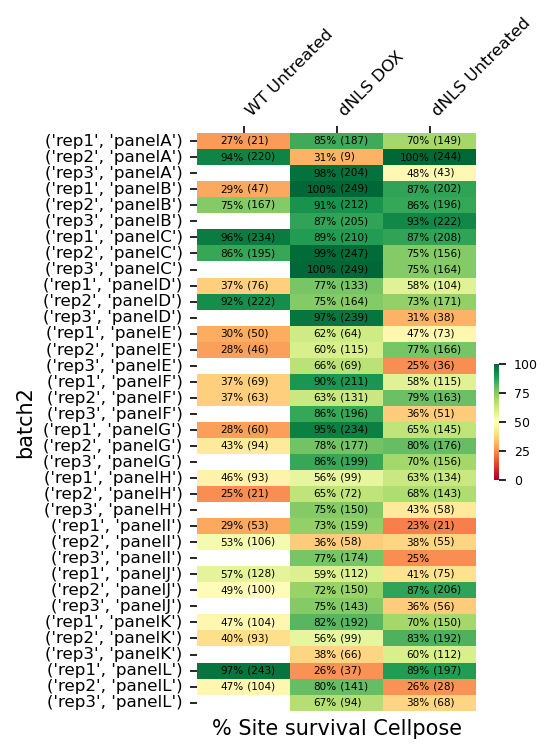

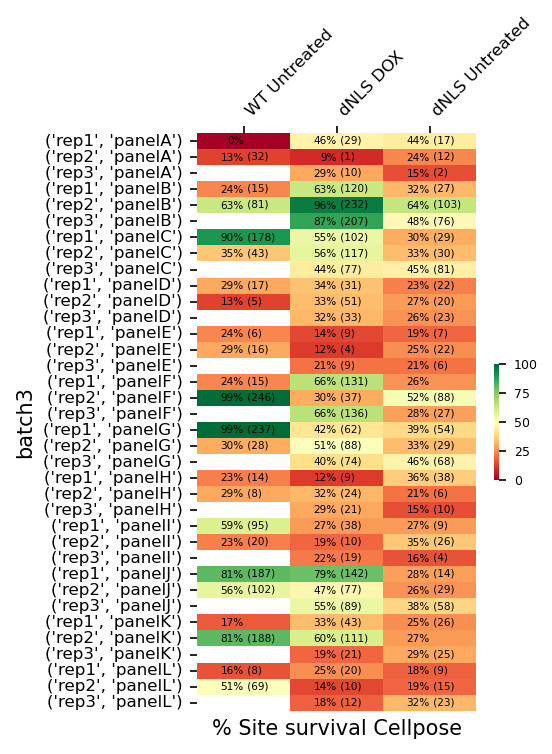

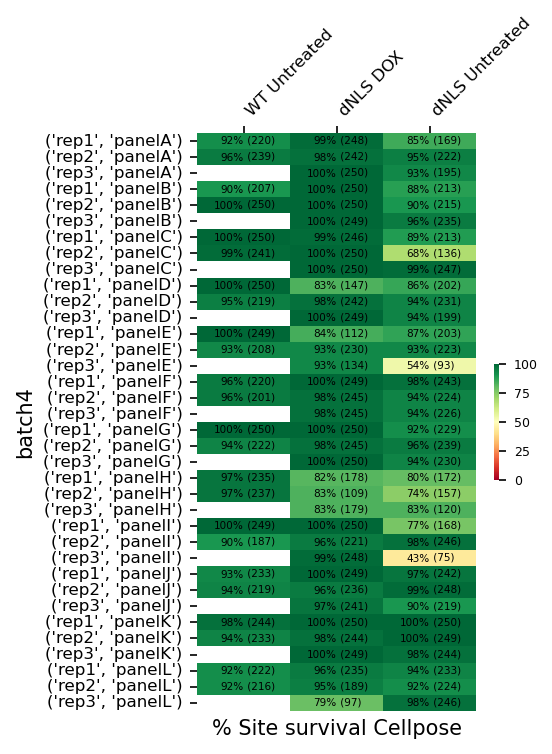

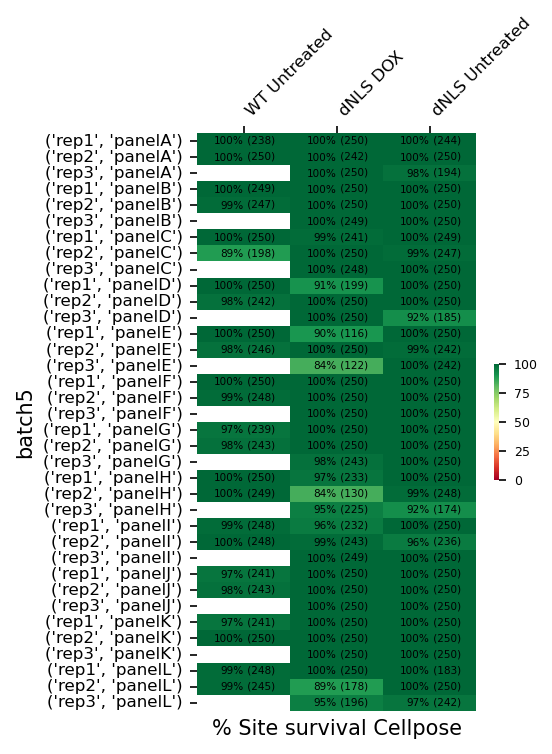

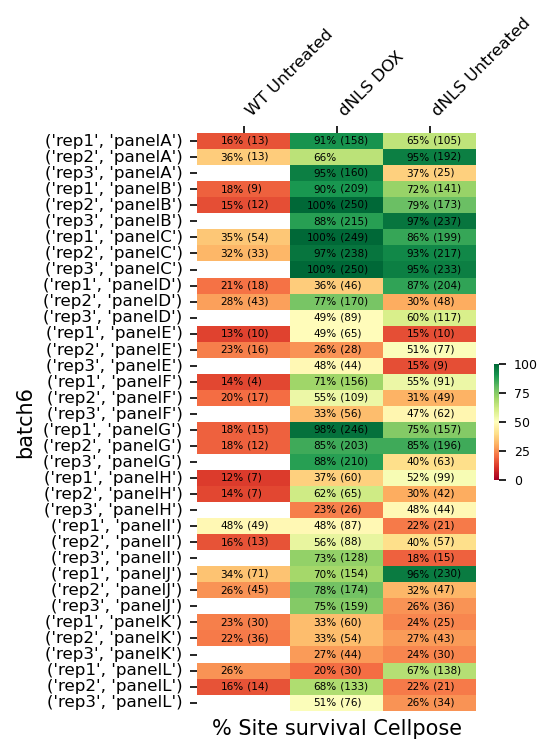

In [31]:
dapi_filter_by_cellpose = show_site_survival_dapi_cellpose(df_dapi, batches, dapi_filter_by_brenner, dnls_opera_line_colors, 
                                                           dnls_opera_panels, dnls_opera_reps, figsize=(3,5),
                                                          to_ignore={'cell_line_cond':'WT Untreated','rep':'rep3'})

### 3. % Site survival by tiling
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values.

**A site will be filtered out if after tiling, no tile is containing at least one whole cell that Cellpose detected.**

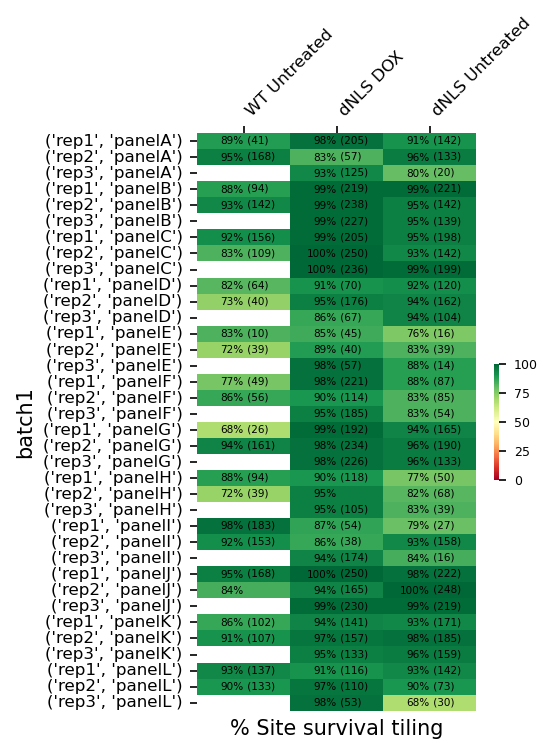

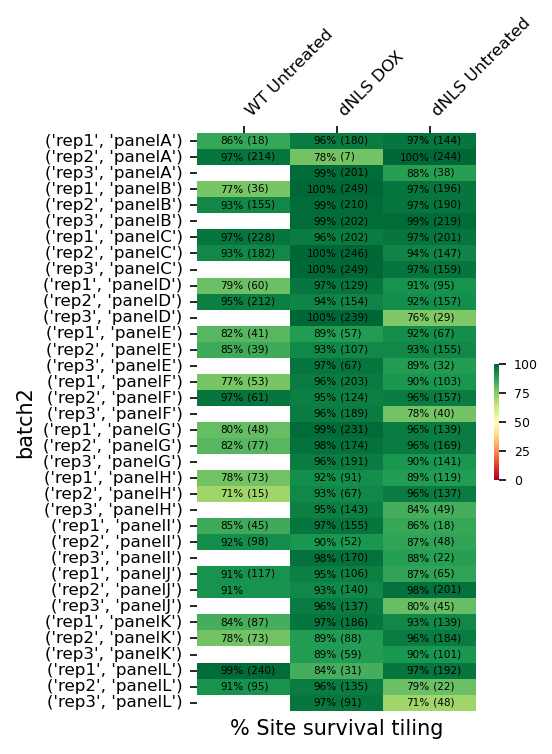

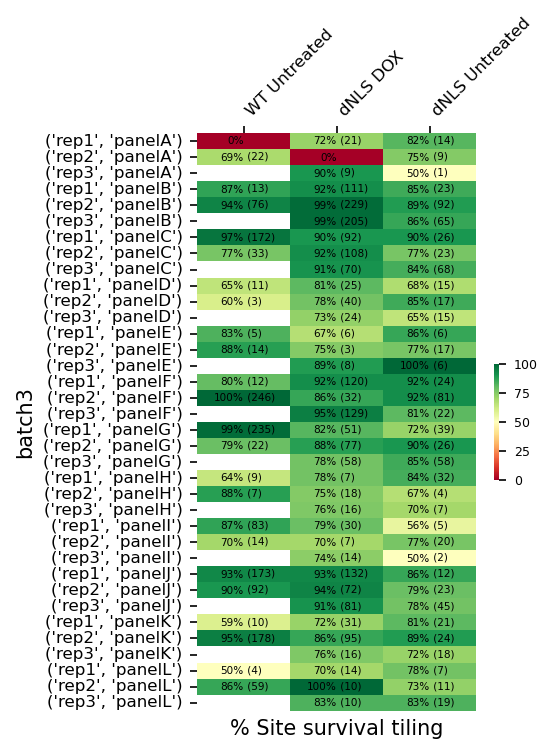

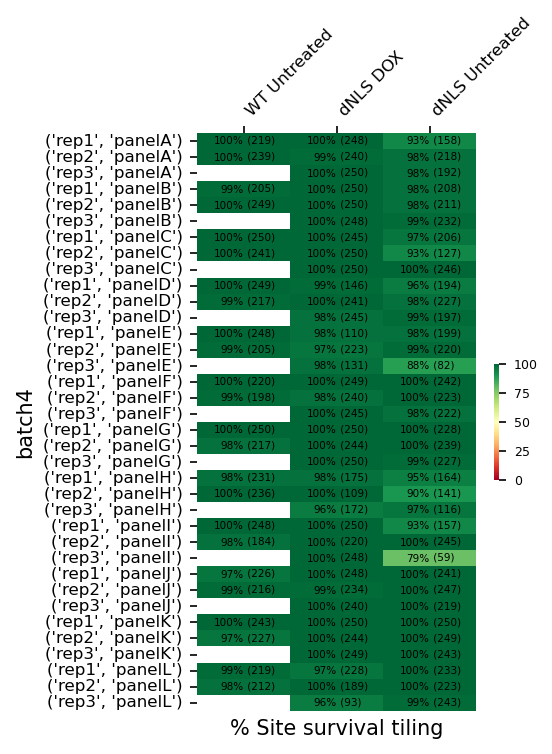

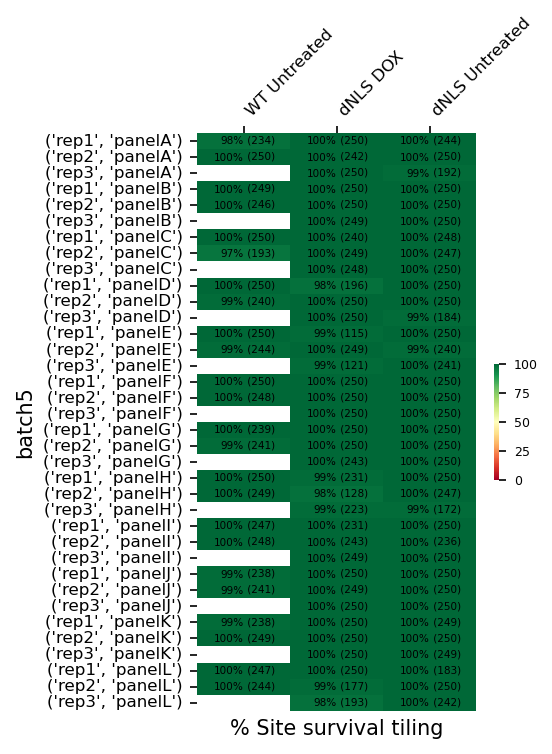

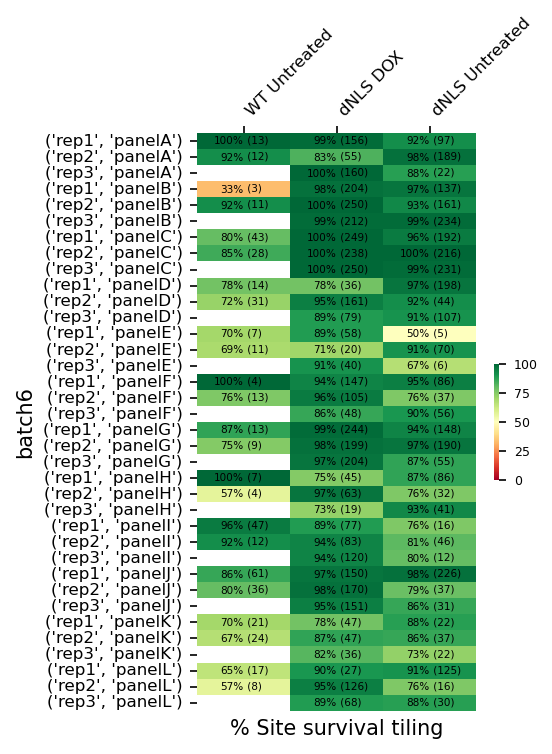

In [32]:
dapi_filter_by_tiling=show_site_survival_dapi_tiling(df_dapi, batches, dapi_filter_by_cellpose, dnls_opera_line_colors, dnls_opera_panels, 
                                                     dnls_opera_reps, figsize=(3,5),
                                                    to_ignore={'cell_line_cond':'WT Untreated','rep':'rep3'})

### 4. % Site survival after Brenner on target channel
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values (if different than the percentages).

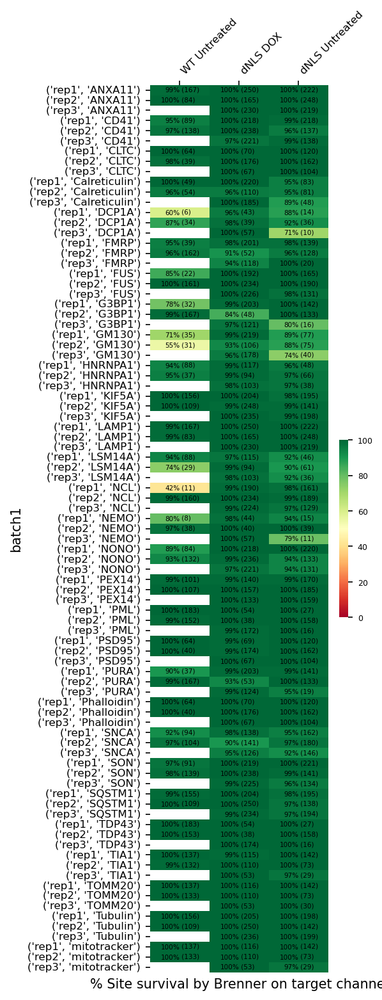

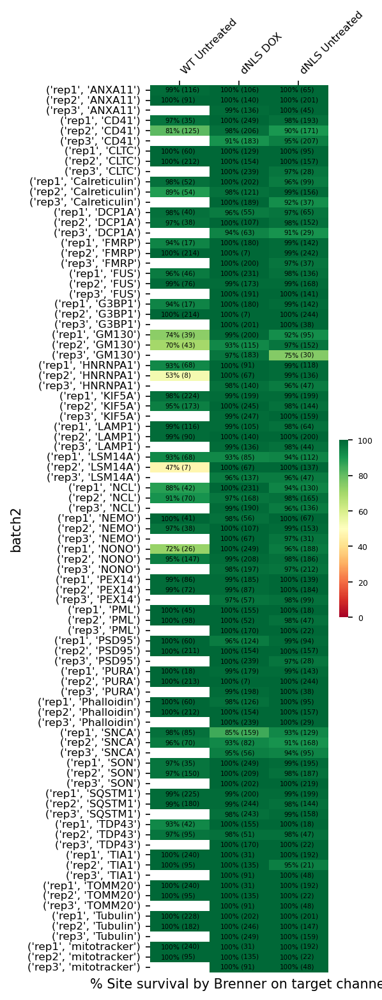

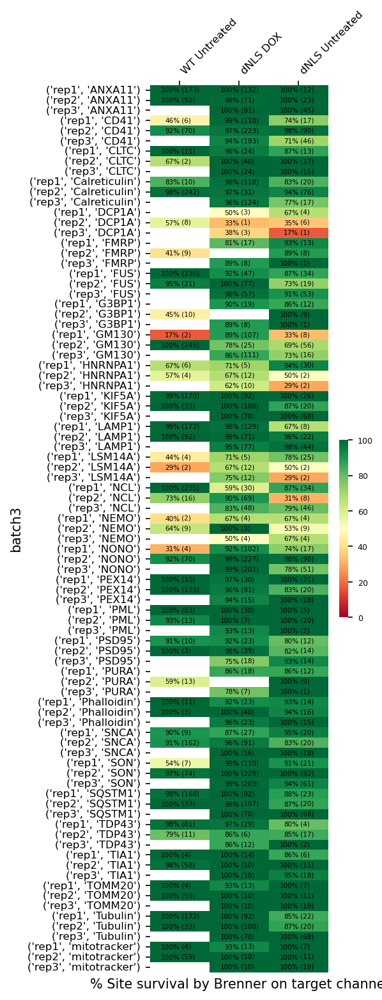

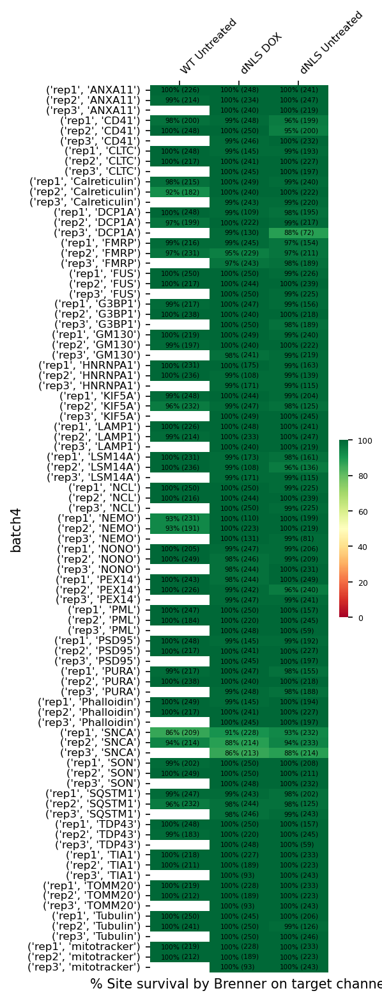

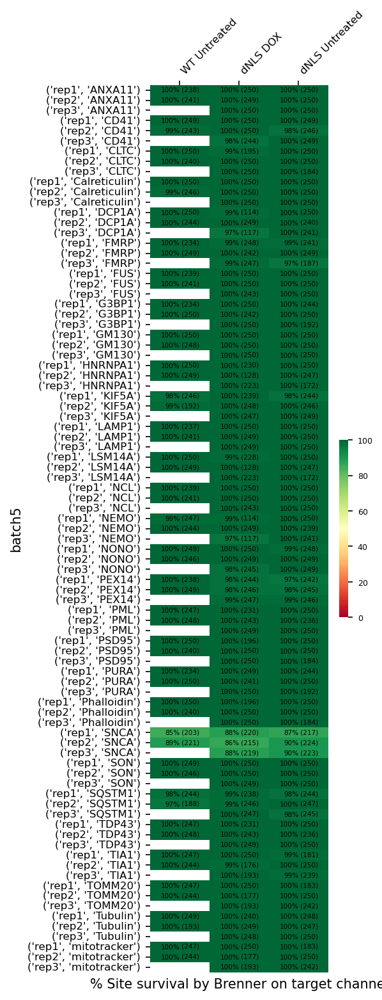

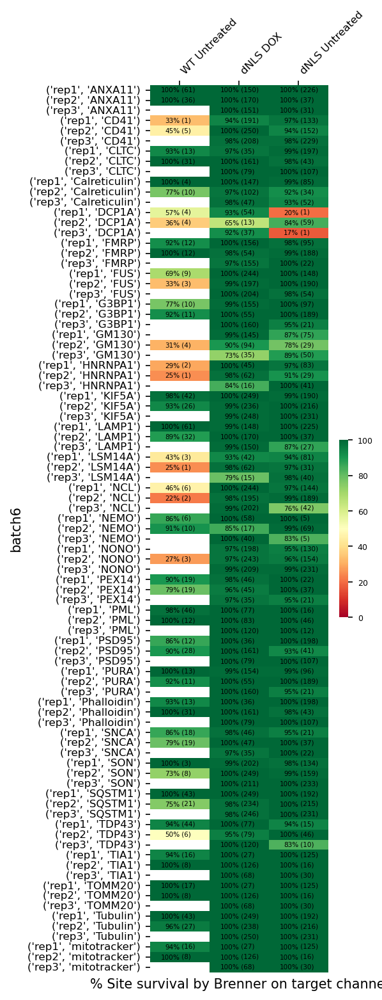

In [33]:
show_site_survival_target_brenner(df_dapi, df_target, dapi_filter_by_tiling, dnls_opera_markers,
                                  batches, dnls_opera_line_colors, dnls_opera_panels, 
                                dnls_opera_reps,figsize=(3,12),to_ignore={'cell_line_cond':'WT Untreated','rep':'rep3'})

## Statistics About the Processed Files

In [34]:
names = ['Total number of tiles', 'Total number of whole cells']
stats = ['n_valid_tiles','site_whole_cells_counts_sum','site_cell_count','site_cell_count_sum']
total_sum = calc_total_sums(df_target, df_dapi, stats, dnls_opera_markers)

### Total tiles

In [36]:
# markers_for_dnls = markers.copy() #TODO need to change according to - if we use all markers or just the d8 ones!!!!
# markers_for_dnls.remove('TIA1')
# markers_for_dnls += ['TDP43B']

total_sum[total_sum.marker.isin(dnls_opera_markers)].n_valid_tiles.sum()

3284865

### Total whole nuclei in tiles

In [37]:
total_sum[total_sum.marker =='DAPI'].site_whole_cells_counts_sum.sum()

590416.0

### Total nuclei in sites

In [38]:
total_sum[total_sum.marker =='DAPI'].site_cell_count.sum()

2101563.0

In [39]:
show_total_sum_tables(total_sum)

,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch1,,,,
count,328.000000,328.000000,328.000000,328.000000
mean,1165.310976,11.653110,707.338415,2507.460366
std,1046.238692,10.462387,630.316108,2303.997273
min,8.000000,0.080000,7.000000,10.000000
25%,256.750000,2.567500,142.250000,481.000000
50%,888.000000,8.880000,569.000000,1826.000000
75%,1750.500000,17.505000,1051.500000,3715.000000
max,3855.000000,38.550000,2417.000000,8549.000000
sum,382222.000000,NaN,232007.000000,822447.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch2,,,,
count,328.000000,328.000000,328.000000,328.000000
mean,1251.137195,12.511372,766.804878,2757.082317
std,1093.680461,10.936805,664.476326,2468.820998
min,14.000000,0.140000,6.000000,21.000000
25%,210.750000,2.107500,120.250000,448.750000
50%,1048.500000,10.485000,652.500000,2291.000000
75%,1955.750000,19.557500,1235.000000,4365.500000
max,4175.000000,41.750000,2560.000000,9746.000000
sum,410373.000000,NaN,251512.000000,904323.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch3,,,,
count,321.000000,321.000000,321.000000,321.000000
mean,324.769470,3.247695,215.959502,718.847352
std,618.632905,6.186329,419.045987,1412.939984
min,0.000000,0.000000,0.000000,0.000000
25%,11.000000,0.110000,7.000000,14.000000
50%,27.000000,0.270000,17.000000,38.000000
75%,388.000000,3.880000,238.000000,801.000000
max,3411.000000,34.110000,2317.000000,7812.000000
sum,104251.000000,NaN,69323.000000,230750.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch4,,,,
count,328.000000,328.000000,328.000000,3.280000e+02
mean,2640.329268,26.403293,1594.823171,5.799652e+03
std,1001.227712,10.012277,601.821307,2.188391e+03
min,182.000000,1.820000,105.000000,3.470000e+02
25%,1923.500000,19.235000,1217.000000,4.386500e+03
50%,2514.500000,25.145000,1530.500000,5.545000e+03
75%,3561.000000,35.610000,2134.250000,7.620000e+03
max,4510.000000,45.100000,2817.000000,9.956000e+03
sum,866028.000000,NaN,523102.000000,1.902286e+06


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch5,,,,
count,3.280000e+02,328.000000,328.000000,3.280000e+02
mean,3.513948e+03,35.139482,2163.140244,7.685512e+03
std,7.562985e+02,7.562985,471.185860,1.763002e+03
min,1.876000e+03,18.760000,1129.000000,4.196000e+03
25%,2.802750e+03,28.027500,1771.000000,5.886500e+03
50%,3.678000e+03,36.780000,2226.000000,8.046500e+03
75%,4.144500e+03,41.445000,2536.000000,9.038000e+03
max,4.955000e+03,49.550000,3248.000000,1.161400e+04
sum,1.152575e+06,NaN,709510.000000,2.520848e+06


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch6,,,,
count,326.000000,326.000000,326.000000,326.000000
mean,1133.177914,11.331779,754.104294,2590.570552
std,1440.228227,14.402282,955.379610,3341.816846
min,1.000000,0.010000,0.000000,1.000000
25%,28.500000,0.285000,18.000000,41.250000
50%,359.500000,3.595000,247.000000,768.000000
75%,2162.000000,21.620000,1419.250000,4786.000000
max,5132.000000,51.320000,3388.000000,12045.000000
sum,369416.000000,NaN,245838.000000,844526.000000


,n valid tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
All batches,,,,
count,1.959000e+03,1959.000000,1.959000e+03,1.959000e+03
mean,1.676807e+03,16.768070,1.036903e+03,3.688198e+03
std,1.482005e+03,14.820055,9.147154e+02,3.294192e+03
min,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
25%,1.420000e+02,1.420000,7.950000e+01,2.690000e+02
50%,1.411000e+03,14.110000,8.600000e+02,3.115000e+03
75%,2.856000e+03,28.560000,1.760000e+03,6.227000e+03
max,5.132000e+03,51.320000,3.388000e+03,1.204500e+04
sum,3.284865e+06,NaN,2.031292e+06,7.225180e+06


### Show Total Tile Counts
For each batch, cell line, replicate and marker: Total number of tiles

#### First, we look at all cell lines togther:

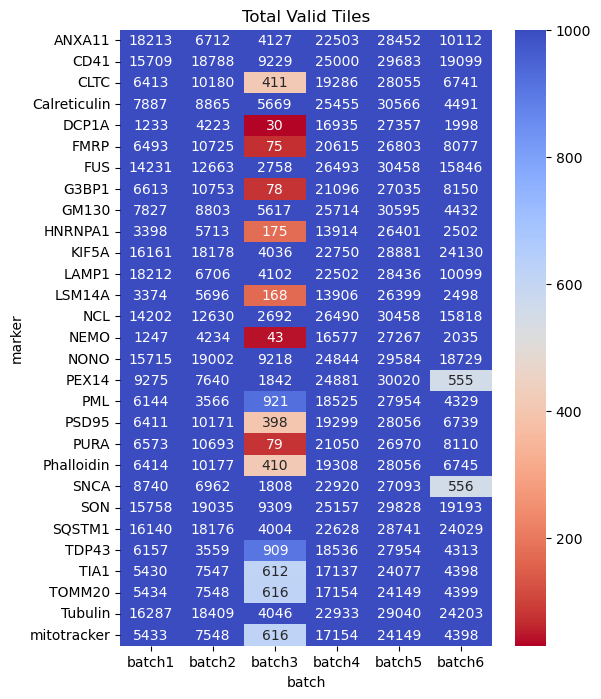

In [75]:
show_total_valid_tiles_per_marker_and_batch(total_sum, vmax=1000)


#### Separating into cell lines & batches:

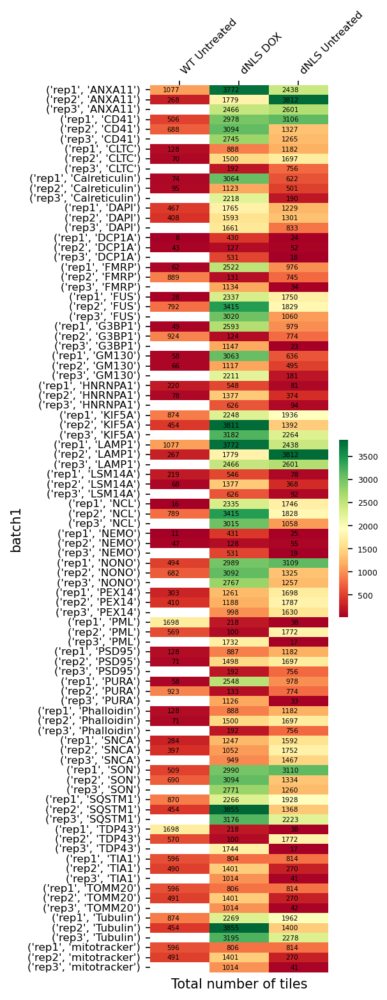

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


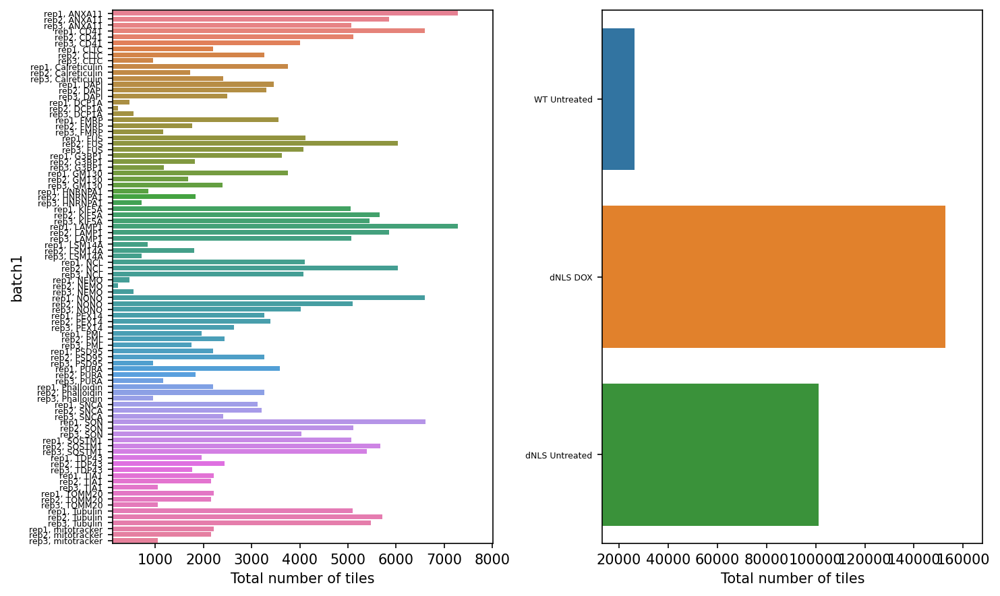

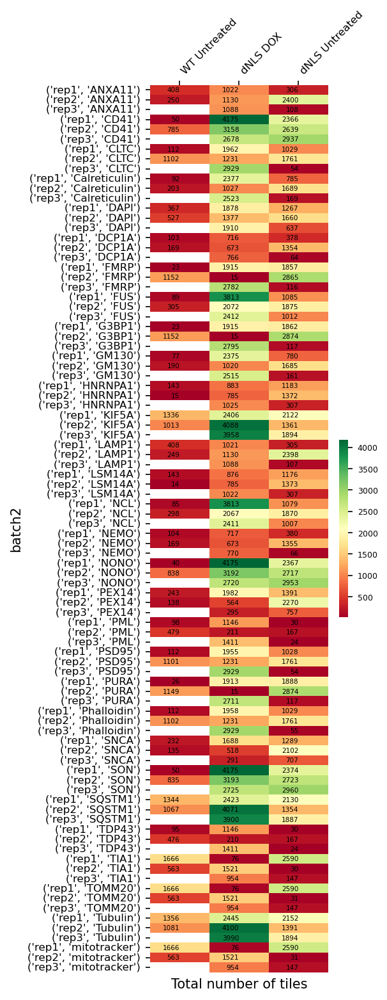

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


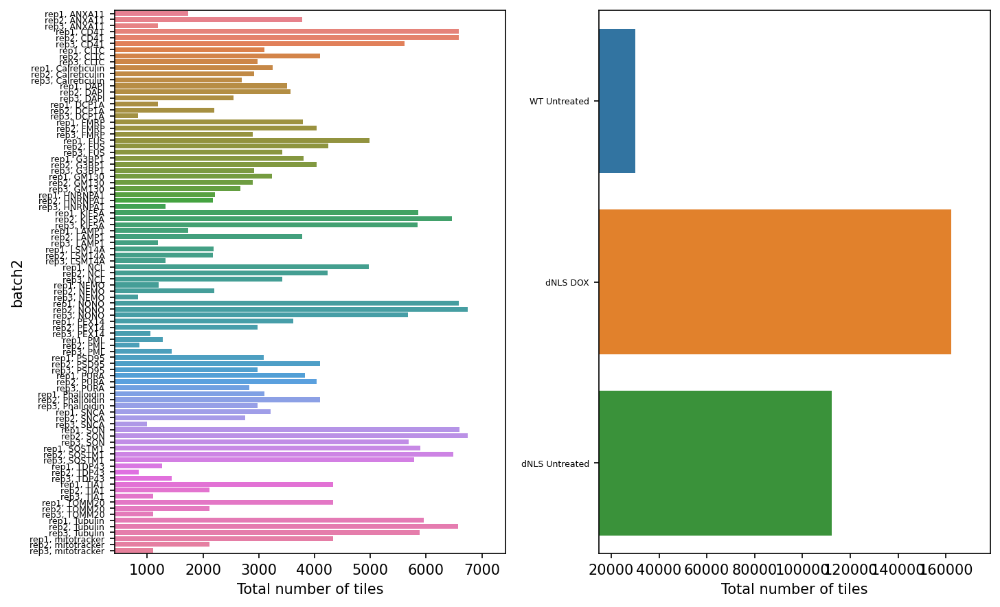

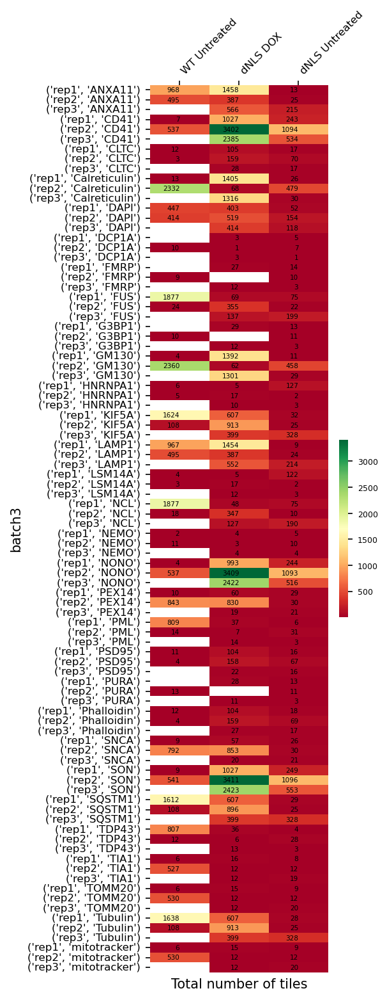

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


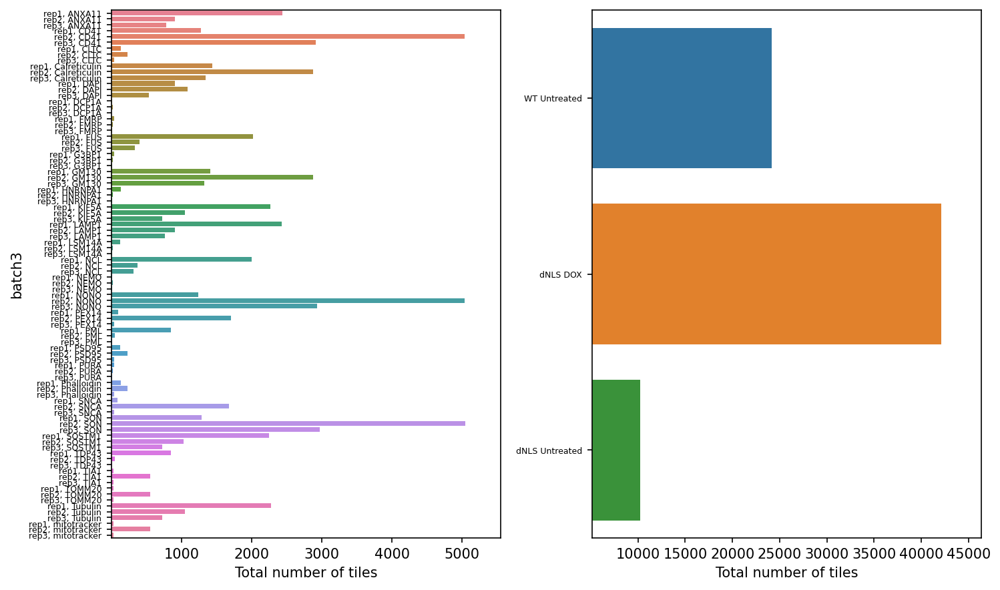

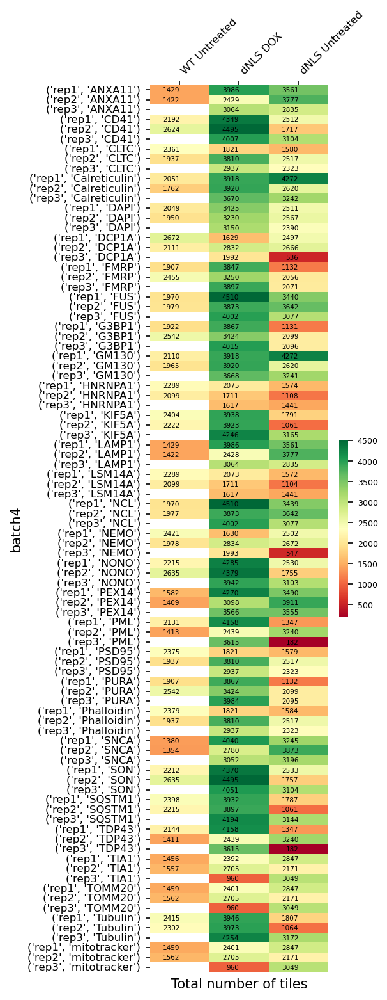

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


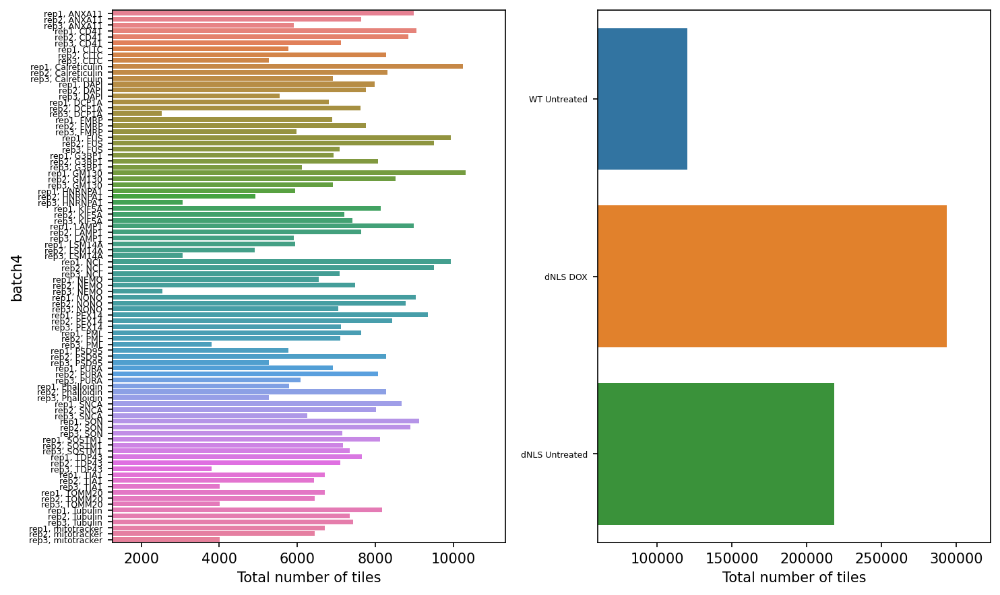

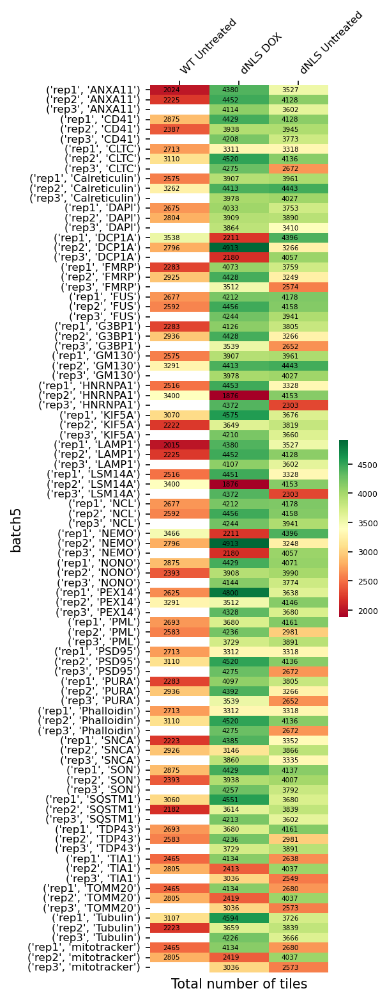

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


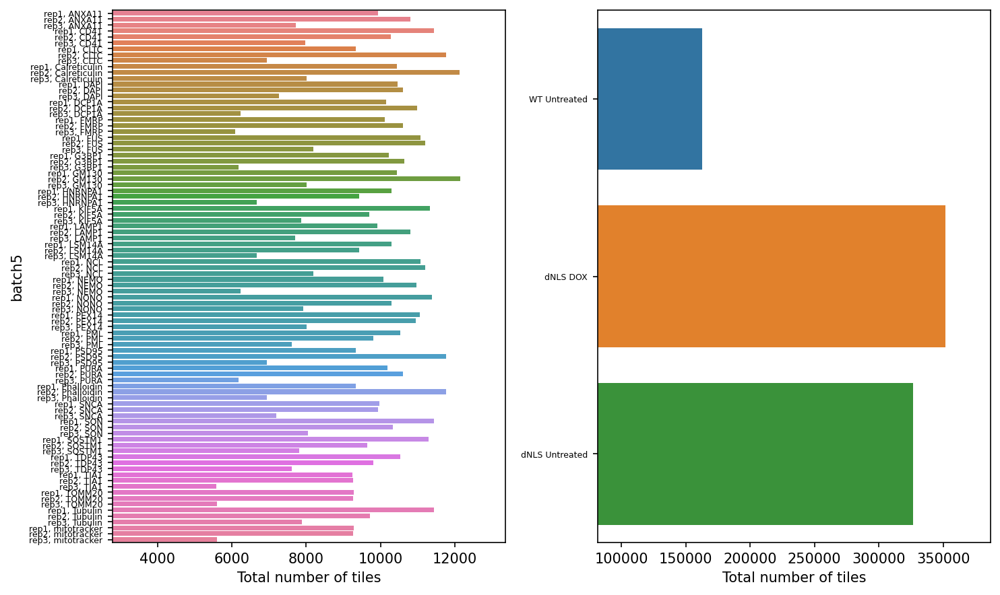

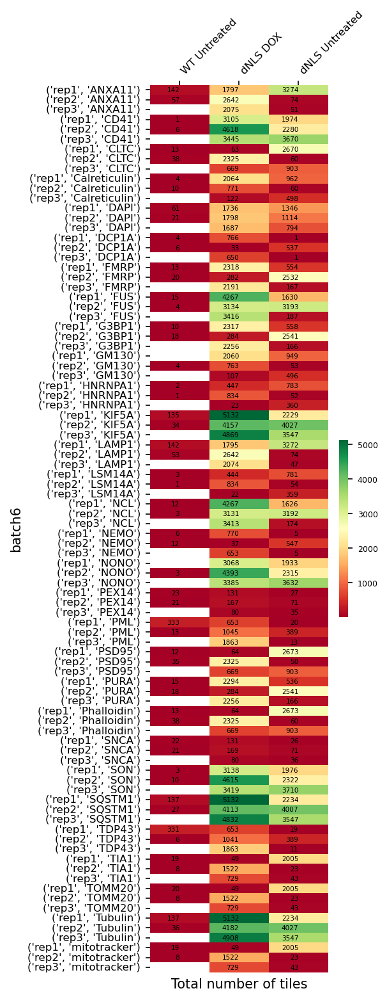

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


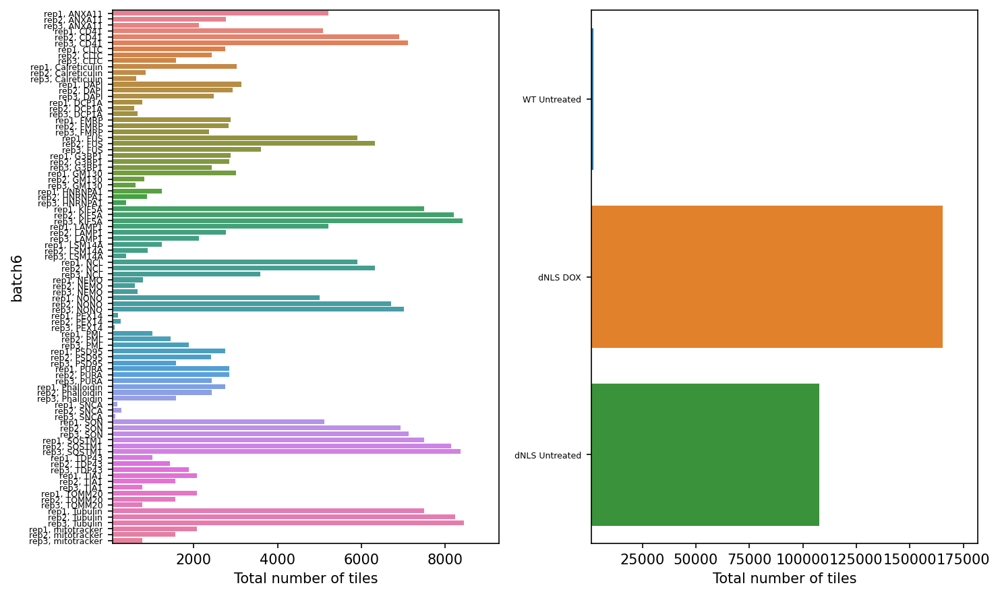

In [51]:
to_heatmap = total_sum.rename(columns={'n_valid_tiles':'index'})
plot_filtering_heatmap(to_heatmap, extra_index='marker', vmin=None, vmax=None,
                      xlabel = 'Total number of tiles', show_sum=True, figsize=(3,12), fmt=".0f")

### Show Total Whole Cell Counts
For each batch, cell line, replicate and markerTotal number of tiles

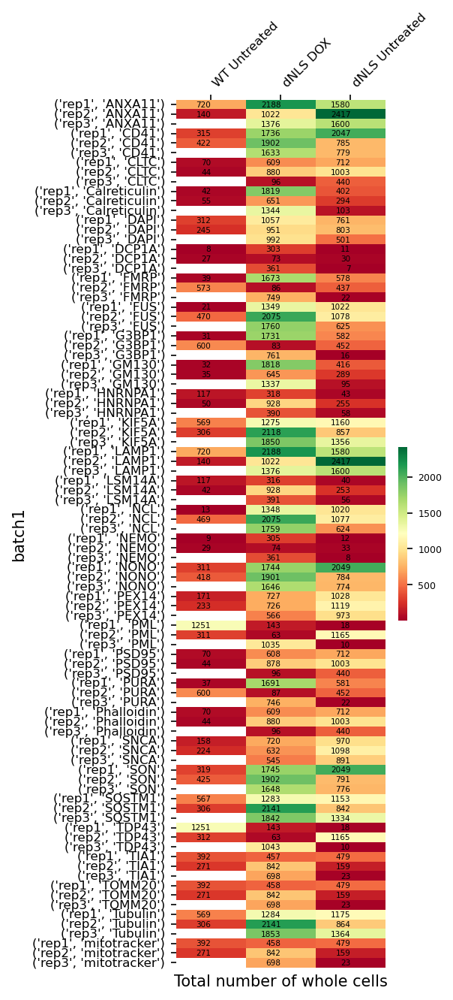

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


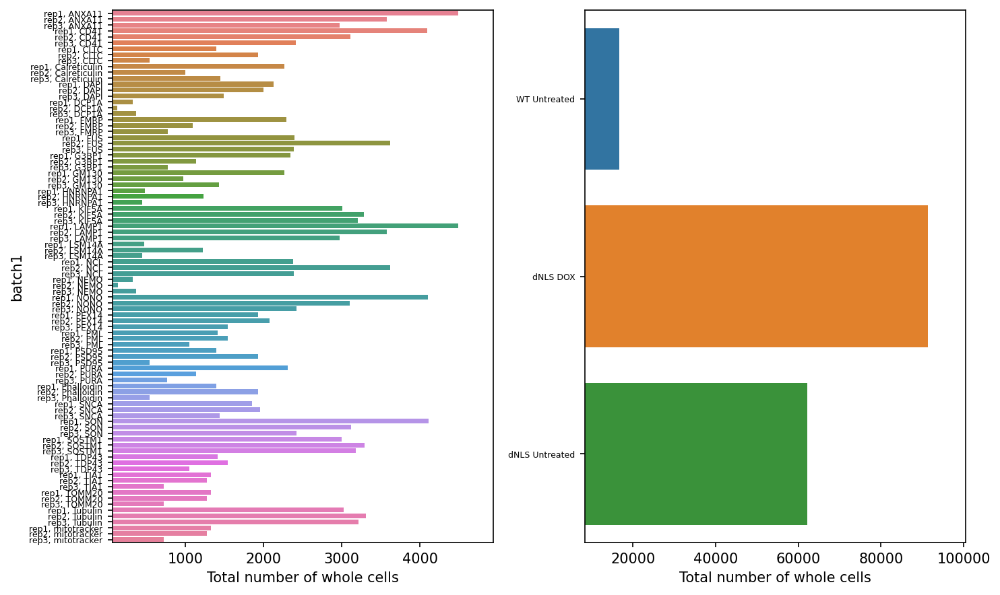

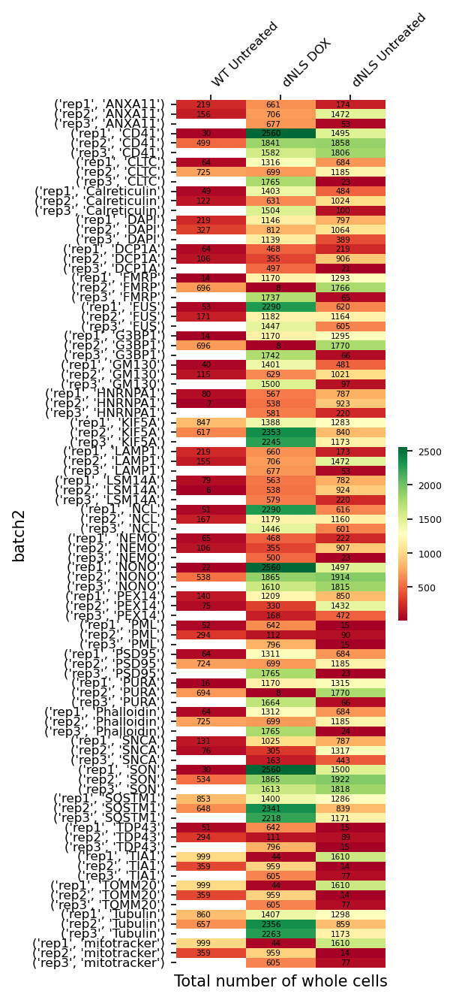

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


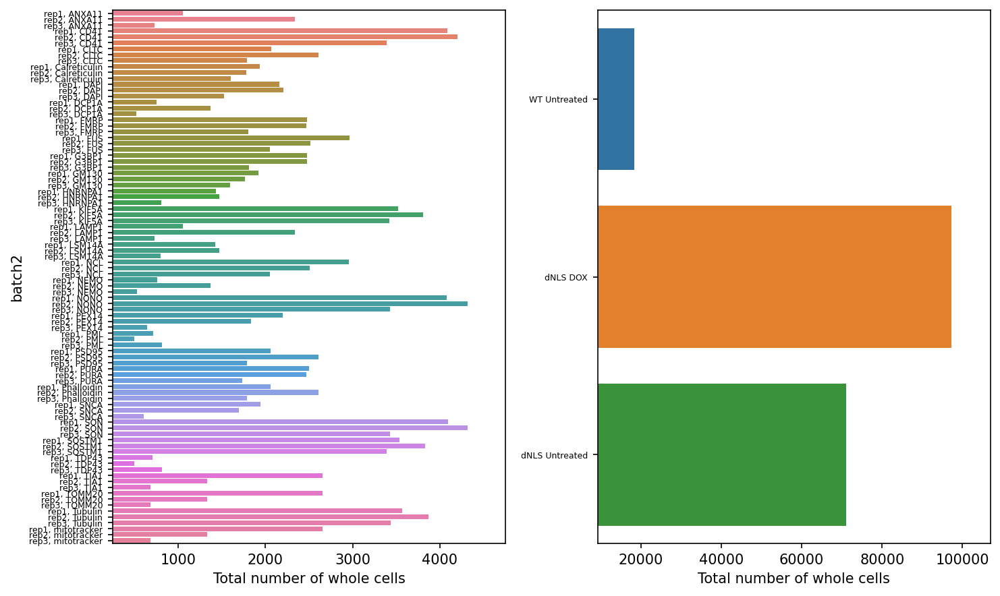

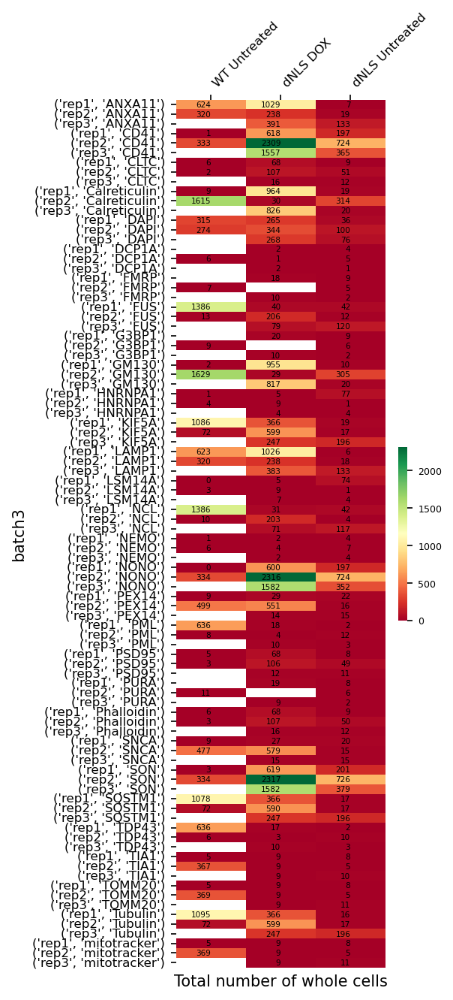

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


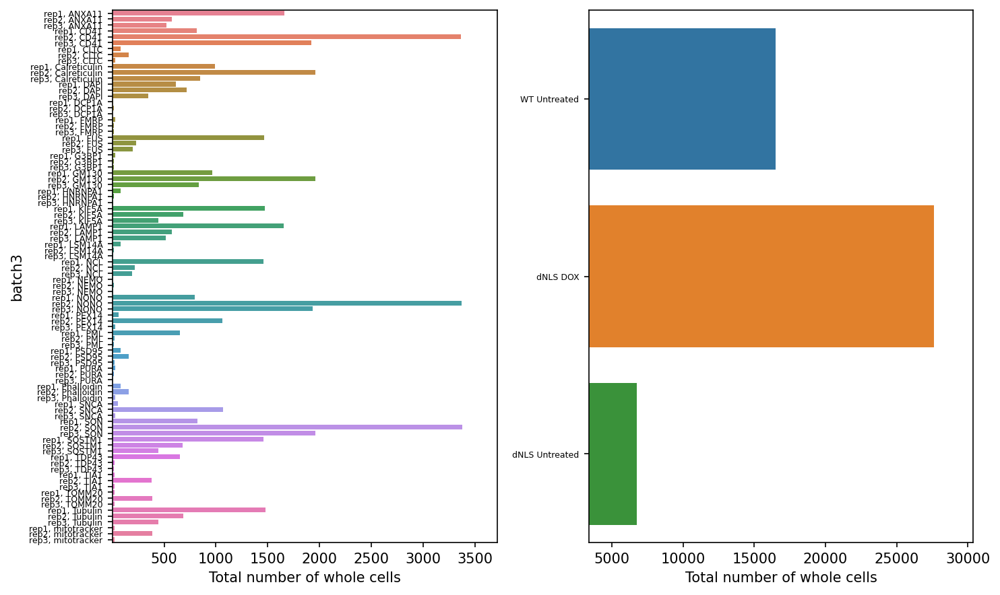

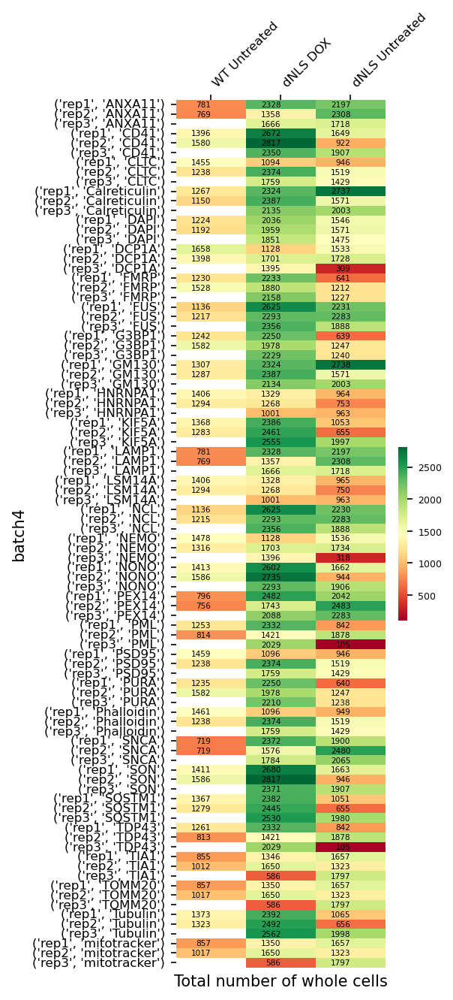

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


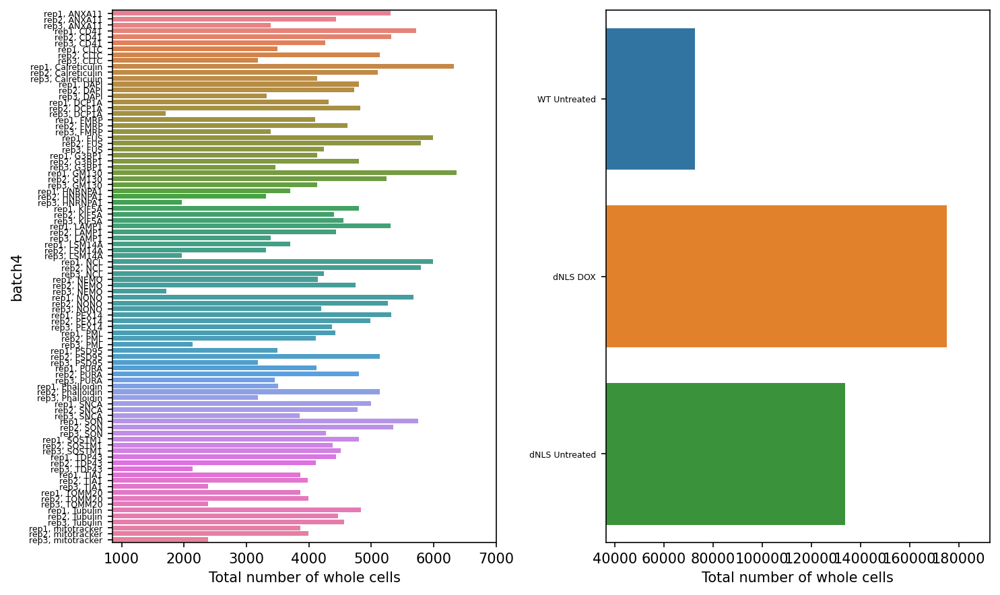

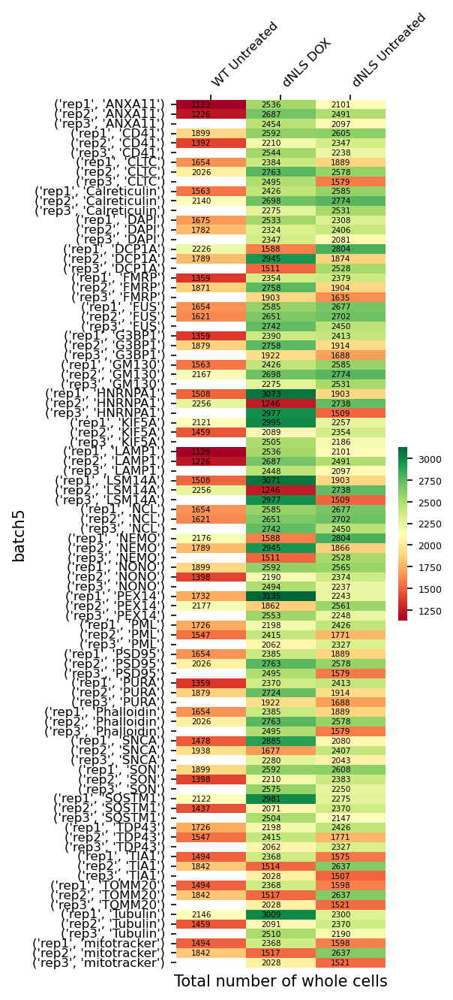

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


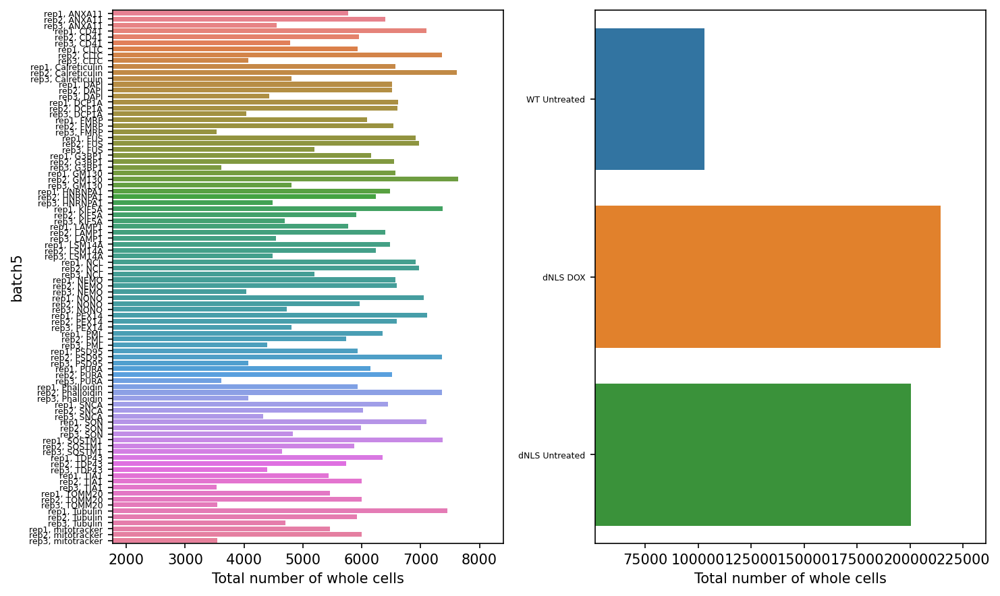

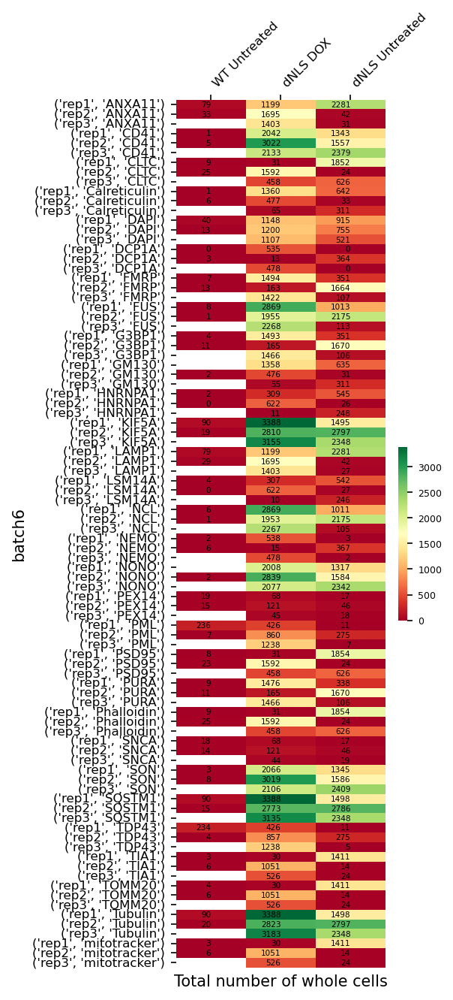

/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_reports/qc_utils.py:388: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


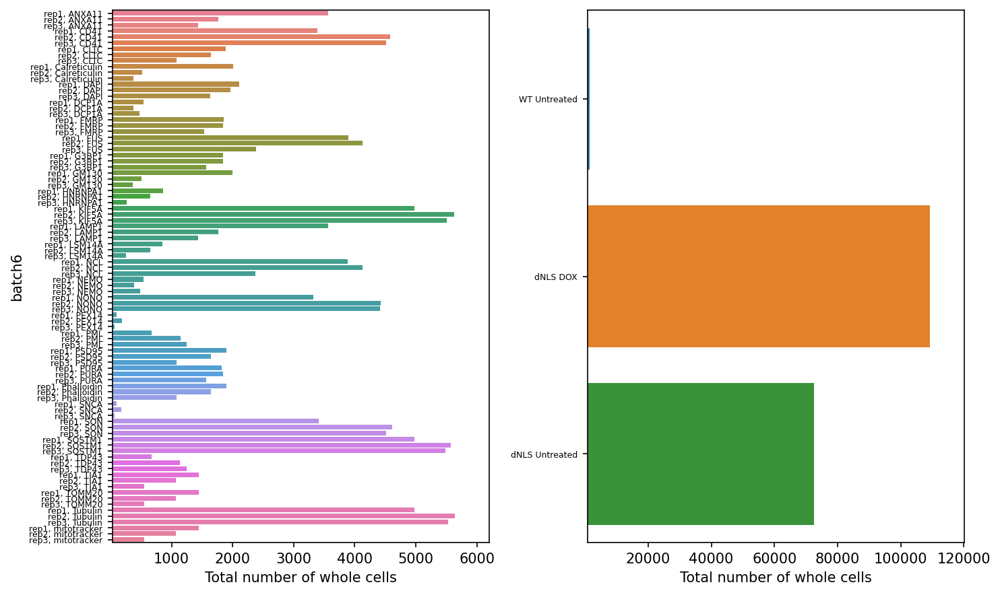

In [52]:
to_heatmap = total_sum.rename(columns={'site_whole_cells_counts_sum':'index'})
plot_filtering_heatmap(to_heatmap, extra_index='marker', vmin=None, vmax=None,
                      xlabel = 'Total number of whole cells', show_sum=True, figsize=(3,10), fmt=".0f")

### Show **Cell Count** Statistics per Batch

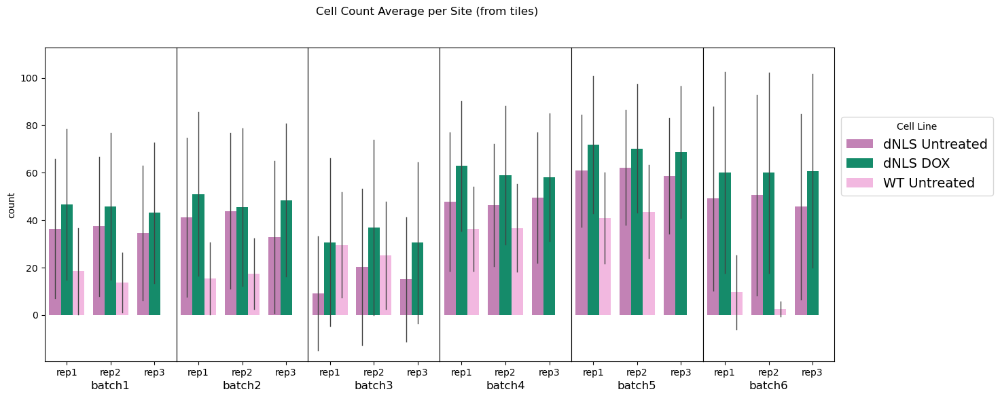

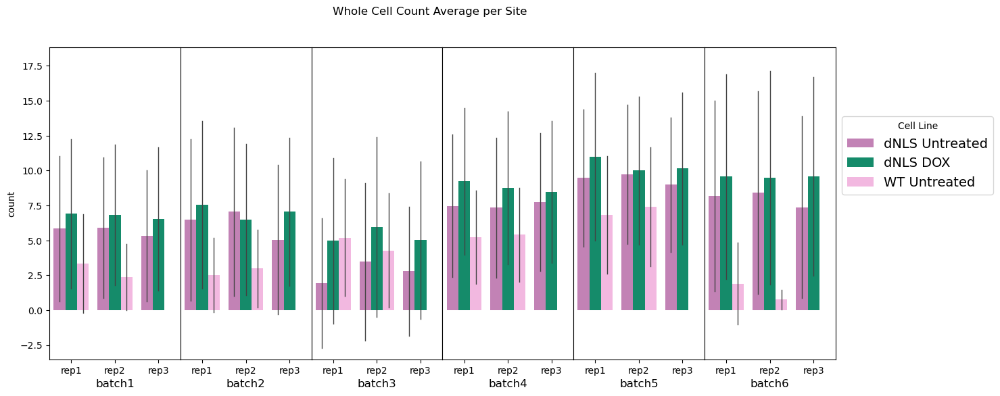

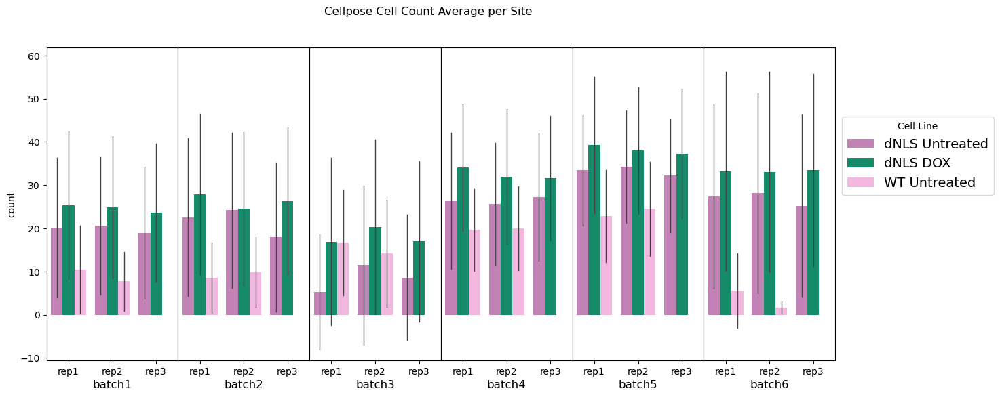

In [53]:
df_no_empty_sites = df_dapi[df_dapi.n_valid_tiles !=0]
plot_cell_count(df_no_empty_sites, dnls_opera_lines_order, dnls_opera_custom_palette, y='site_cell_count_sum', 
                title='Cell Count Average per Site (from tiles)')

plot_cell_count(df_no_empty_sites, dnls_opera_lines_order, dnls_opera_custom_palette, y='site_whole_cells_counts_sum',
                title='Whole Cell Count Average per Site')

plot_cell_count(df_no_empty_sites, dnls_opera_lines_order, dnls_opera_custom_palette, y='site_cell_count',
               title='Cellpose Cell Count Average per Site')


### Show **Tiles** per Site Statistics


In [54]:
df_dapi.groupby(['cell_line_cond']).n_valid_tiles.mean()

cell_line_cond
WT Untreated       5.531196
dNLS DOX          10.952855
dNLS Untreated     8.820095
Name: n_valid_tiles, dtype: float64

In [55]:
df_dapi[['site_cell_count']].mean()

site_cell_count    19.466487
dtype: float64

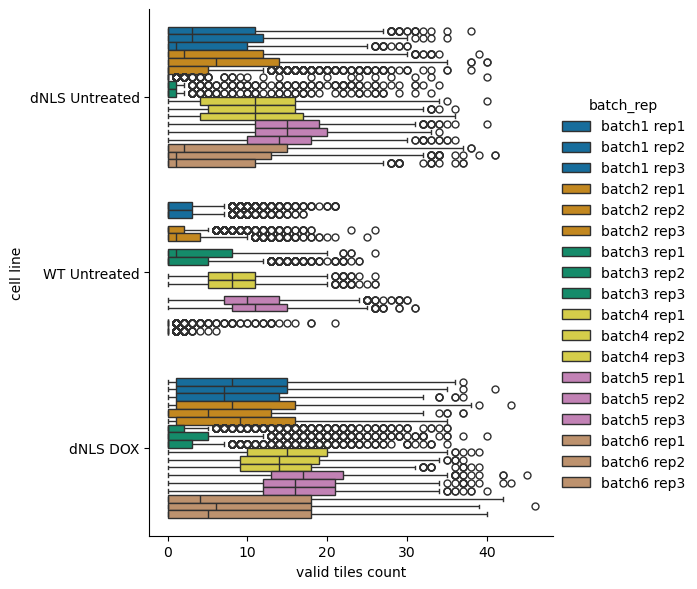

In [56]:
plot_catplot(df_dapi, custom_palette,dnls_opera_reps, x='n_valid_tiles', x_title='valid tiles count', batch_min=1, batch_max=6, height=6)


### Show Mean of cell count in valid tiles

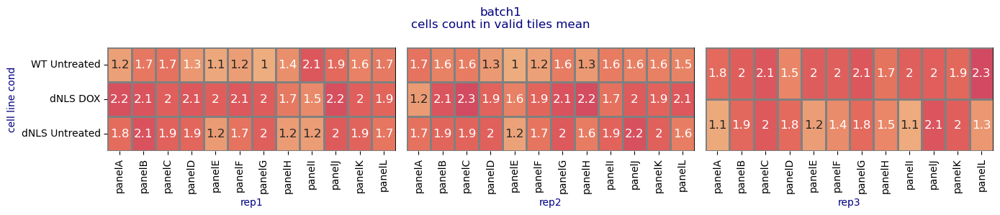

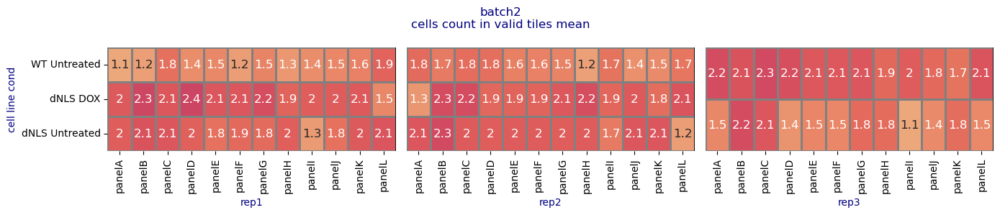

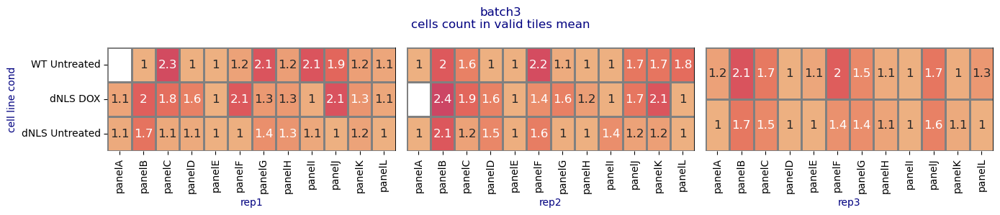

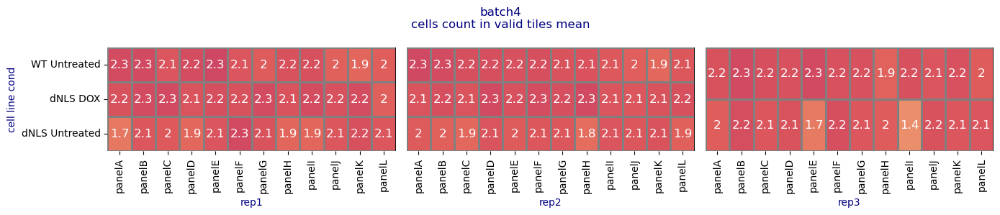

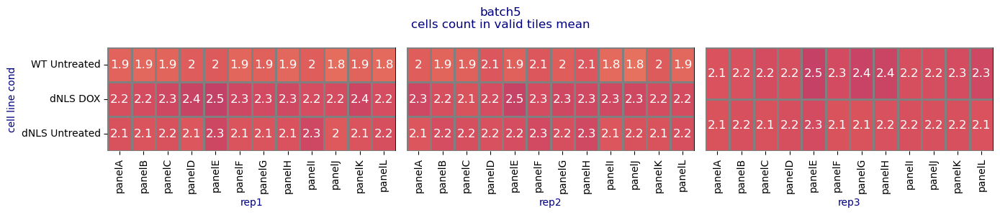

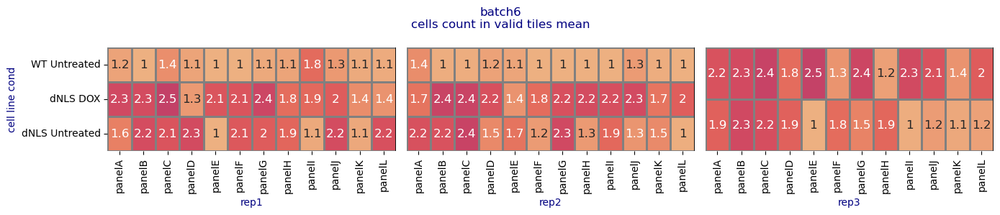

In [70]:
plot_hm_of_mean_cell_count_per_tile(df_dapi, split_by='rep', rows='cell_line_cond', columns='panel', figsize=(14,3))


# Assessing Staining Reproducibility and Outliers

In [ ]:
# for batch in batches:
#     print(batch)
#     run_calc_hist_new(f'{batch}', dnls_opera_cell_lines_for_disp, dnls_opera_markers,
#                       root_directory_raw, root_directory_proc,
#                            hist_sample=10,sample_size_per_markers=200, ncols=8, nrows=4, dnls=True)
#     print("="*30)

In [72]:
# save notebook as HTML ( the HTML will be saved in the same folder the original script is)
from IPython.display import display, Javascript
display(Javascript('IPython.notebook.save_checkpoint();'))
os.system(f'jupyter nbconvert --to html tools/preprocessing_tools/qc_reports/qc_report_dNLS_Opera.ipynb --output {NOVA_HOME}/manuscript/preprocessing_qc_reports/qc_report_dNLS_Opera.html')
# os.system(f'jupyter nbconvert --to html tools/preprocessing_tools/qc_reports/qc_report_dNLS_Opera.ipynb')

<IPython.core.display.Javascript object>

[NbConvertApp] Converting notebook tools/preprocessing_tools/qc_reports/qc_report_dNLS_Opera.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 72 image(s).
[NbConvertApp] Writing 22046562 bytes to /home/projects/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/manuscript/preprocessing_qc_reports/qc_report_dNLS_Opera.html


0